## Capstone: Exploratory Data Analysis




---


---
```
Due: 2025-02-19
DSCI/STAT 8950  
Jason Driscoll
```
---



#### Import Statements
---
```
Data manipulation libraries.
- pandas
- markdown
- numpy

Base visualization libraries.
- matplotlib.pyplot
- seaborn
- plotly.express
  - plotly.io
  - Image export utlility: kaleido

Mapping libraries/utilities.
- geopandas
- folium
  - folium.plugins  
  - HeatMap  
- community.community_louvain  
  - scipy.spatial.distance  
  - cdist
- mapclassify

Graph-specific visualization libraries.
- networkx
  - networkx.algorithms: bipartite

Control display preferences.
- warnings

```

---



In [ ]:
# Data handling.
import pandas as pd
import markdown
import numpy as np

# Visualization.
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.io as pio
try:
  import kaleido
  import geopandas
  import folium
  import community.community_louvain as community_louvain
  import warnings
  import datetime
except:
  ! python -m pip install kaleido
  ! python -m pip install geopandas
  ! python -m pip install folium
  ! python -m pip install python-louvain
  ! python -m pip install warnings
  ! python -m pip install datetime

# Mapping.
import geopandas as gpd
import folium
from folium.plugins import HeatMap
import community.community_louvain as community_louvain
from scipy.spatial.distance import cdist
import folium
from folium.plugins import HeatMap
import community.community_louvain as community_louvain
from scipy.spatial.distance import cdist
try:
  import mapclassify
except:
  ! python -m pip install mapclassify

# Nodal visualization.
# import networkx as nx
# from networkx.algorithms import bipartite

# Control display settings.
import warnings
warnings.filterwarnings(action="ignore")

# See how long it takes.
import datetime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 28.6 MB/s eta 0:00:00
ERROR: Could not find a version that satisfies the requirement warnings (from versions: none)
ERROR: No matching distribution found for warnings
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.6/52.6 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.8/259.8 kB 23.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.1/59.1 kB 6.1 MB/s eta 0:00:00


#### Import Data

In this analysis I'll be focusing on the Superfund Site data set and the Cancer Incidence Rate Tables by County. The statistics of each data set are shown below. Of note is that both data sets are from well-maintained government sources, and it seems they require very little data cleaning to be in a workable state, particularly when considering only the columns of interest.

Cancer Incidence consists only of complete entries, 3144 in each column.

Superfund Sites consists of 47041 observations, and there are some missing values in some columns. For the most part (as in Address 2) these missing values are not of concern because those columns aren't needed to plot the locations - the latitude and longitude are both available and more precise.

```
Cancer Incidence Rate Tables by County

Original Data Source:
[1] “State Cancer Profiles > Incidence Rates Table.” Accessed: Feb. 07, 2025.   
    [Online]. Available: https://www.statecancerprofiles.cancer.gov/incidencerates/index.php

    data specific link:
    https://www.statecancerprofiles.cancer.gov/incidencerates/index.php?
    stateFIPS=00&areatype=county&cancer=001&race=00&sex=0&age=001&
    type=incd&sortVariableName=rate&sortOrder=default&output=0#results

RangeIndex: 3144 entries, 0 to 3143
Data columns (total 15 columns):
 #   Column                                                        Non-Null Count  Dtype
---  ------                                                        --------------  -----
 0   County                                                        3144 non-null   object
 1   State                                                         3143 non-null   object
 2   FIPS                                                          3144 non-null   int64
 3   2023 Rural-Urban Continuum Codes([rural urban note])          3143 non-null   object
 4   Age-Adjusted Incidence Rate([rate note]) - cases per 100,000  3144 non-null   object
 5   Lower 95% Confidence Interval                                 3144 non-null   object
 6   Upper 95% Confidence Interval                                 3144 non-null   object
 7   CI*Rank([rank note])                                          3144 non-null   object
 8   Lower CI (CI*Rank)                                            3144 non-null   object
 9   Upper CI (CI*Rank)                                            3144 non-null   object
 10  Average Annual Count                                          3144 non-null   object
 11  Recent Trend                                                  3144 non-null   object
 12  Recent 5-Year Trend ([trend note]) in Incidence Rates         3144 non-null   object
 13  Lower 95% Confidence Interval.1                               3144 non-null   object
 14  Upper 95% Confidence Interval.1                               3144 non-null   object
dtypes: int64(1), object(14)
memory usage: 368.6+ KB
```

```
Superfund Sites Minimalized

Original Data Source:
[2] O. US EPA, “Superfund Data and Reports.” Accessed: Feb. 07, 2025.
    [Online]. Available: https://www.epa.gov/superfund/superfund-data-and-reports
  
    data specific link: https://semspub.epa.gov/src/document/HQ/406041

RangeIndex: 47041 entries, 0 to 47040
Data columns (total 21 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Region                      47041 non-null  int64  
 1   Site Name                   47041 non-null  object
 2   EPA ID                      47041 non-null  object
 3   Address 1                   47020 non-null  object
 4   Address 2                   1147 non-null   object
 5   City                        47041 non-null  object
 6   State                       47041 non-null  object
 7   Zip Code                    47038 non-null  object
 8   County                      45823 non-null  object
 9   Primary Latitude            47041 non-null  float64
 10  Primary Longitude           47041 non-null  float64
 11  NPL Status                  47041 non-null  object
 12  Site Category               47041 non-null  object
 13  Category Code               47041 non-null  object
 14  HRS Score                   44430 non-null  float64
 15  Listing (Finalized) Date    46702 non-null  object
 16  Proposed Date               47041 non-null  object
 17  Deleted Date                8368 non-null   float64
 18  Preferred Contaminant Name  47041 non-null  object
 19  CAS Number                  47041 non-null  object
 20  Site ID                     47041 non-null  int64  
dtypes: float64(4), int64(2), object(15)
memory usage: 7.5+ MB
```



---



In [ ]:
start_time = datetime.datetime.now()

In [ ]:
cancer_raw_df = pd.read_csv('/content/1. CSV - Cancer Incidence Rate Tables by County.csv')
superfund_raw_df = pd.read_csv('/content/1. CSV - Superfund_Sites_Minimalized.csv')
display(cancer_raw_df.info())
display(superfund_raw_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3144 entries, 0 to 3143
Data columns (total 15 columns):
 #   Column                                                        Non-Null Count  Dtype 
---  ------                                                        --------------  ----- 
 0   County                                                        3144 non-null   object
 1   State                                                         3143 non-null   object
 2   FIPS                                                          3144 non-null   int64 
 3   2023 Rural-Urban Continuum Codes([rural urban note])          3143 non-null   object
 4   Age-Adjusted Incidence Rate([rate note]) - cases per 100,000  3144 non-null   object
 5   Lower 95% Confidence Interval                                 3144 non-null   object
 6   Upper 95% Confidence Interval                                 3144 non-null   object
 7   CI*Rank([rank note])                                          3144 non-null   

None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47041 entries, 0 to 47040
Data columns (total 21 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Region                      47041 non-null  int64  
 1   Site Name                   47041 non-null  object 
 2   EPA ID                      47041 non-null  object 
 3   Address 1                   47020 non-null  object 
 4   Address 2                   1147 non-null   object 
 5   City                        47041 non-null  object 
 6   State                       47041 non-null  object 
 7   Zip Code                    47038 non-null  object 
 8   County                      45823 non-null  object 
 9   Primary Latitude            47041 non-null  float64
 10  Primary Longitude           47041 non-null  float64
 11  NPL Status                  47041 non-null  object 
 12  Site Category               47041 non-null  object 
 13  Category Code               470

None

#### Data Cleaning: Superfund_Sites_Minimalized

Here a working Superfund data set is created to hold the raw data set unchanged. Only the relevant columns are extracted, including the latitude and longitude. Site Name, Address 1, County are also considered relevant because they may be needed later to assist with merging the superfund data frame with the geospatial data.

A working Cancer Incidence data set is also created. Since the incidence rate is of interest it is extracted along with the County, State and FIPS number, which are likely necessary for mapping and merging the data.



```
superfund_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1718 entries, 0 to 47017
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Site Name          1718 non-null   object
 1   Address 1          1717 non-null   object
 2   County             1694 non-null   object
 3   Primary Latitude   1718 non-null   float64
 4   Primary Longitude  1718 non-null   float64
dtypes: float64(2), object(3)
memory usage: 80.5+ KB

--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------

cancer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3144 entries, 0 to 3143
Data columns (total 4 columns):
 #   Column                                                        Non-Null Count  Dtype
---  ------                                                        --------------  -----
 0   County                                                        3144 non-null   object
 1   State                                                         3143 non-null   object
 2   FIPS                                                          3144 non-null   int64
 3   Age-Adjusted Incidence Rate([rate note]) - cases per 100,000  3144 non-null   object
dtypes: int64(1), object(3)
memory usage: 98.4+ KB

```
---


In [ ]:
# Create a working dataframe, preserve raw data, select relevant columns.
superfund_df = superfund_raw_df[['Site Name', 'Address 1', 'County', 'Primary Latitude', 'Primary Longitude']].drop_duplicates().copy()

# Enforce numeric format for [['Primary Latitude'],['Primary Longitude']].
superfund_df['Primary Latitude'] = pd.to_numeric(superfund_df['Primary Latitude'], errors='coerce')
superfund_df['Primary Longitude'] = pd.to_numeric(superfund_df['Primary Longitude'], errors='coerce')

# Create a working dataframe, preserve raw data, select relevant columns.
cancer_df = cancer_raw_df[['County', 'State', 'FIPS', 'Age-Adjusted Incidence Rate([rate note]) - cases per 100,000']].drop_duplicates().copy()

# Display the info.
display(superfund_df.info())
display(cancer_df.info())

<class 'pandas.core.frame.DataFrame'>
Index: 1718 entries, 0 to 47017
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Site Name          1718 non-null   object 
 1   Address 1          1717 non-null   object 
 2   County             1694 non-null   object 
 3   Primary Latitude   1718 non-null   float64
 4   Primary Longitude  1718 non-null   float64
dtypes: float64(2), object(3)
memory usage: 80.5+ KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3144 entries, 0 to 3143
Data columns (total 4 columns):
 #   Column                                                        Non-Null Count  Dtype 
---  ------                                                        --------------  ----- 
 0   County                                                        3144 non-null   object
 1   State                                                         3143 non-null   object
 2   FIPS                                                          3144 non-null   int64 
 3   Age-Adjusted Incidence Rate([rate note]) - cases per 100,000  3144 non-null   object
dtypes: int64(1), object(3)
memory usage: 98.4+ KB


None

#### Data Cleaning: Cancer Incidence Rate Tables by County

The Cancer Incidence data set requires a little data cleaning.
- The ridiculously awkward column title 'Age-Adjusted Incidence Rate([rate note]) - cases per 100,000' is immediately renamed to 'incidence_rate'.
- Then the county column is dealt with by stripping the state name and region code, leaving the pristine county name.
- incident_rate is coerced to numeric through the whole column. There are non-numeric values, particularly asterisks or sentences declaring data wasn't available. The handling of those will be discussed later, but in short, it isn't appropriate to impute those values over the broad geographic areas they are found in, so the numeric conversion can be coerced.
- since the data set was downloaded as an .xlsx, converted to .csv, and then uploaded, this always makes me nervous that Excel has gotten it's hands on the values and decided to strip leading zeroes or that some of the values need to be text. So the int data type is enforced through the column.
- Dropping rows where 'fips' == 0 removes the national level data, since we only want the county incidence this makes sense. Dropping 'fips' == 12125 removes an extreme confounding outlier. The handling of this outlier is discussed in more detail later, but essentially non-geographic structural circumstances lead to a county in Florida having an incidence rate over 1200 per 100,000, more than 500 points higher than the next highest incidence rate among the counties, wreaking havoc with attempts to map the data using propotional binning methods. So it is cut.
- NAs are cut - discussion why appears later, but the primary source of missing values in incidence_rate are from states in which data is not available and there is little basis for selecting an imputation throughout an entire state.
- total cleaned observations are 2932, down from 3144, and all rows are populated. Result:

```
<class 'pandas.core.frame.DataFrame'>
Index: 2932 entries, 2 to 2933
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   county          2932 non-null   object
 1   state           2932 non-null   object
 2   fips            2932 non-null   int64  
 3   incidence_rate  2932 non-null   float64
dtypes: float64(1), int64(1), object(2)
memory usage: 114.5+ KB
```

---

In [ ]:
# Create a working dataframe, preserve raw data.
cancer_df = cancer_raw_df[['County', 'State', 'FIPS', 'Age-Adjusted Incidence Rate([rate note]) - cases per 100,000']].drop_duplicates().copy()

# Rename an awkward column.
cancer_df = cancer_df.rename(columns={
    'County': 'county',
    'State': 'state',
    'FIPS': 'fips',
    'Age-Adjusted Incidence Rate([rate note]) - cases per 100,000': 'incidence_rate',
    })

# Remove state name and number from the county column.
cancer_df['county'] = cancer_df['county'].str.replace(r",\s*\w+\(\d+\)", "", regex=True).str.strip()
# Enforce numeric format for [['incidence_rate'],['fips']].
cancer_df['incidence_rate'] = pd.to_numeric(cancer_df['incidence_rate'], errors='coerce')
cancer_df['fips'] = cancer_df['fips'].astype(int)
# Drop the national data.
cancer_df = cancer_df[cancer_df['fips'] > 0]
# Drop the extreme outlier Union County, Florida (fips: 12125, incidence rate: 1248.4)
cancer_df = cancer_df[cancer_df['fips'] != 12125]
# Drop na
cancer_df = cancer_df.dropna(subset=['incidence_rate'])
cancer_df.sort_values(by='incidence_rate', ascending=False).head()
display(cancer_df.info())

<class 'pandas.core.frame.DataFrame'>
Index: 2932 entries, 2 to 2933
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   county          2932 non-null   object 
 1   state           2932 non-null   object 
 2   fips            2932 non-null   int64  
 3   incidence_rate  2932 non-null   float64
dtypes: float64(1), int64(1), object(2)
memory usage: 114.5+ KB


None

#### Test the base for mapping  data sets.

We just make a blank map and overlay the county shapefile to make sure it's
 presentable and we have the correct lat/long and figure size locked in.

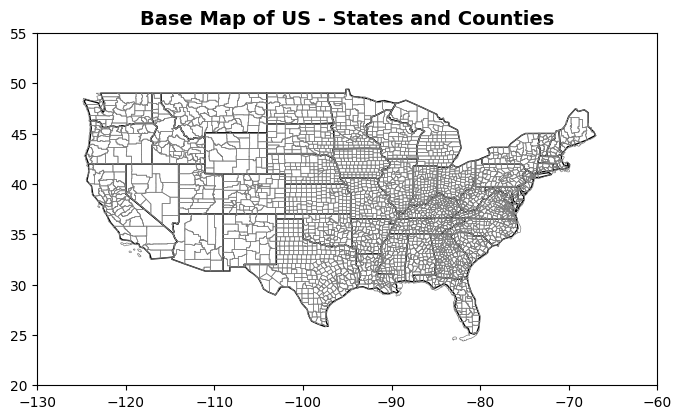

(20.0, 55.0)

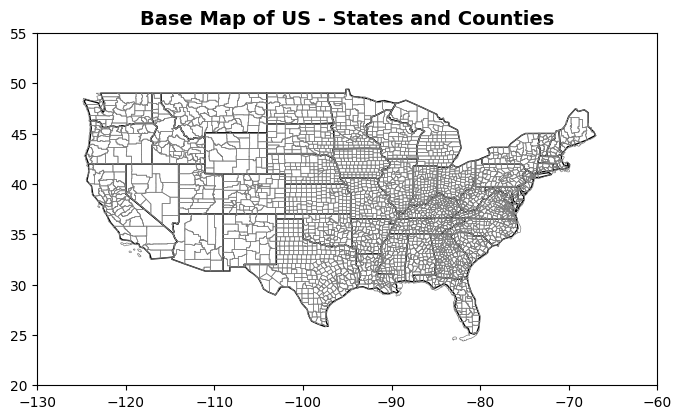

In [ ]:
# Create a base map.
world_map = gpd.read_file('/content/ne_110m_admin_0_countries.shp')
us_map = world_map[world_map.ADMIN == "United States of America"]
state_boundaries = gpd.read_file('/content/ne_110m_admin_1_states_provinces.shp')
state_lines = state_boundaries[state_boundaries["iso_a2"] == "US"]
county_shapes = gpd.read_file('/content/tl_2023_us_county.shp')

# Create a figure and set a default size.
figure_sz = [8, 6]
fig, ax = plt.subplots(figsize=figure_sz)

# Set map background and state border aesthetics.
us_map.plot(ax=ax, color='white')
state_lines.plot(ax=ax, color='none', edgecolor='black', linewidth=1)
county_shapes.plot(ax=ax, color='none', edgecolor='grey', linewidth=.5)

ax.set_title('Base Map of US - States and Counties', fontsize=14, fontweight='bold')
ax.set_xlim([-130, -60])
ax.set_ylim([20, 55])

#### Initial Visualization: Superfund_Sites_Minimalized

Here are the plots of the locations of the superfund sites on the map of the US. The plots are tested with and without county shapes to make sure adding county shapes does not clutter the map to the point of unreadability. I think it looks clear after adjusting the aesthetics. Then the plot is repeated using a density mapping since the scatterpoint plotting reveals come intense clustering where the number of points covers most of the geographic shape data. Once plotted by density we can locate two areas of high intensity clustering, the first located over the New Jersey, Pennsylvania and New York tri-state area. The second located around the base of Lake Michigan, to Lake Eerie, and involving the Chicago area, northern Indiana and northern Ohio.
There are some additional local concentrations of medium-high concentration in Washington state, California around the San Francisco area, Florida, Louisiana and South Carolina/Georgia, but these aren't clear enough to quantify visually based on the density plot and will need to be analyzed statistically.




Visualization of Superfund Site Distribution Within the US
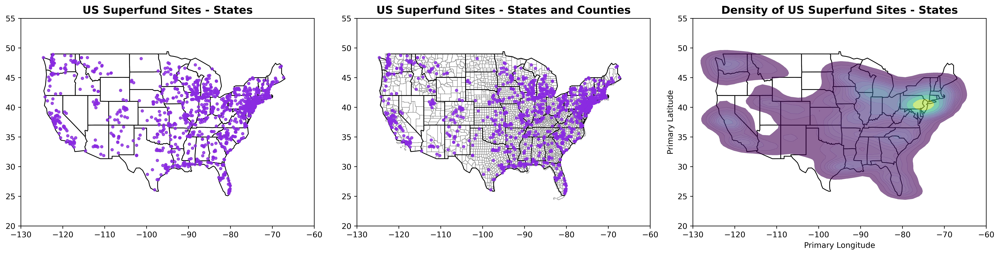

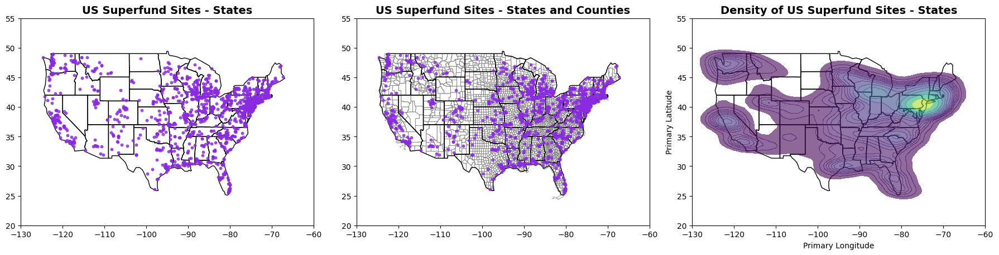

In [ ]:
# Create figure with 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 12))

# Apply the first mapping - Superfund sites on base map.
ax = axes[0]
us_map.plot(ax=ax, color='white')
state_lines.plot(ax=ax, color='none', edgecolor='black', linewidth=1)
ax.scatter(superfund_df['Primary Longitude'], superfund_df['Primary Latitude'],
           color='blueviolet', alpha=0.8, s=10
)
ax.set_title('US Superfund Sites - States', fontsize=14, fontweight='bold')
ax.set_xlim([-130, -60])
ax.set_ylim([20, 55])

# Apply the second mapping - add county border shapes.
ax = axes[1]
us_map.plot(ax=ax, color='white')
county_shapes.plot(ax=ax, color='none', edgecolor='grey', linewidth=0.5)
state_lines.plot(ax=ax, color='none', edgecolor='black', linewidth=1)
ax.scatter(superfund_df['Primary Longitude'], superfund_df['Primary Latitude'],
           color='blueviolet', alpha=0.8, s=10
)
ax.set_title('US Superfund Sites - States and Counties', fontsize=14, fontweight='bold')
ax.set_xlim([-130, -60])
ax.set_ylim([20, 55])

# Apply the third mapping - transition to density.
ax = axes[2]
us_map.plot(ax=ax, color='white')
state_lines.plot(ax=ax, color='none', edgecolor='black', linewidth=1)
sns.kdeplot(
    x=superfund_df['Primary Longitude'],
    y=superfund_df['Primary Latitude'],
    ax=ax, fill=True, cmap='viridis', alpha=0.6, levels=15, bw_adjust=0.5
)
ax.set_title('Density of US Superfund Sites - States', fontsize=14, fontweight='bold')
ax.set_xlim([-130, -60])
ax.set_ylim([20, 55])

plt.tight_layout()
plt.savefig('superfund_trifold.png', dpi=500, bbox_inches='tight')
plt.show()

#### Summary Statistics: Cancer Incidence Rate Tables by County

This is just a quick summary statistic breakdown showing the cumulative rates at which the observations fall within the range, produced because the visualizations make it clear that the majority of observations fall within the three largest bins from 400 to 550 – indeed, these three bins contain ~80% of observations. The median lies around ~493, and there is a bit of skew to the distribution, raising the question of whether the distribution requires adjustment. My conclusion is that with the final model not yet determined, and the likelihood of using models not sensitive to slight distribution issues, such as tree-based models, adjusting isn't necessary at this time, but might become necessary if linear models are selected. Skewness is also checked and the result reported in the next section.  

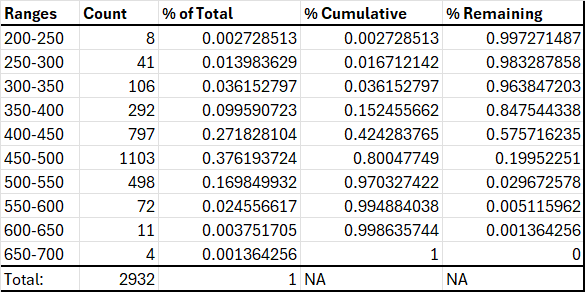

Summary statistic visualizations
- Plot of incidence distribution.
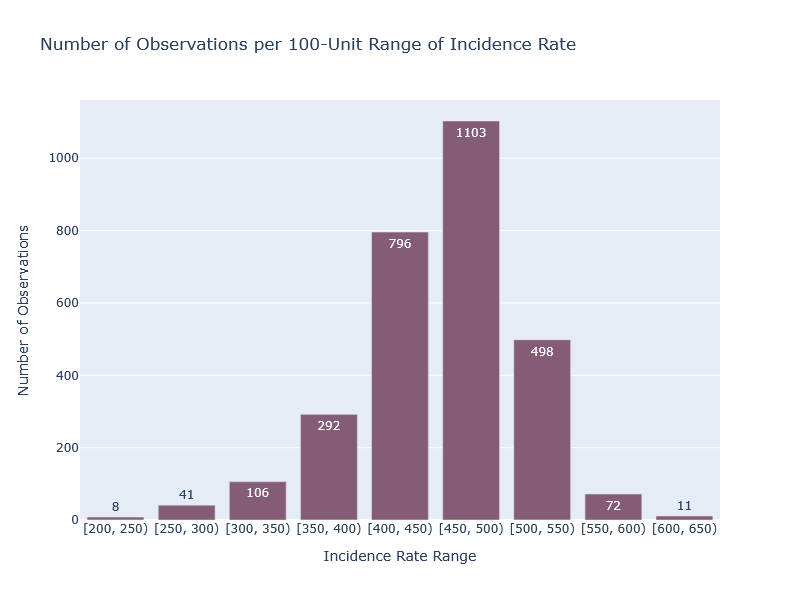

- Boxplot of incidence range
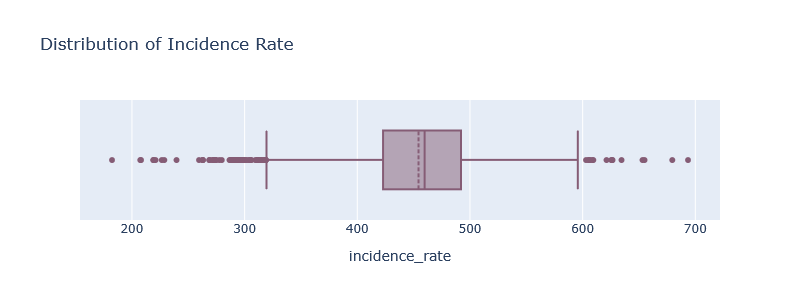



In [ ]:
# Define bins for frequency chart.
bin_edges = list(range(200, 700, 50))

# Create bins - count observations
binning_df = cancer_df.copy()
binning_df['incidence_bin'] = pd.cut(binning_df['incidence_rate'], bins=bin_edges, right=False)

# Count observations in each bin
count_df = binning_df['incidence_bin'].value_counts().reset_index()
count_df.columns = ['incidence_rate', 'count']

# Convert bins to string format
# Filter bins with zero count
count_df = count_df[count_df['count'] > 0]
# Convert bins to string
count_df['incidence_rate'] = count_df['incidence_rate'].astype(str)
# Define custom order
count_df = count_df.sort_values(by='incidence_rate')
count_df['incidence_rate'] = count_df['incidence_rate'].astype(str)

# Plot the bar chart
fig = px.bar(count_df, x='incidence_rate', y='count',
    height=600, width=800, color_discrete_sequence=px.colors.qualitative.Antique,
    title='Number of Observations per 100-Unit Range of Incidence Rate',
    labels={'incidence_rate': 'Incidence Rate Range', 'count': 'Number of Observations'},
    text_auto=True
)
fig.update_layout(
    xaxis={
        'categoryorder': 'array',
        'categoryarray': [
            '[200, 250)', '[250, 300)', '[300, 350)', '[350, 400)', '[400, 450)',
            '[450, 500)', '[500, 550)', '[550, 600)', '[600, 650)'
        ]
          }
)
display(fig.show())

overall_bx_plt = px.box(binning_df, x='incidence_rate',
                          color_discrete_sequence=px.colors.qualitative.Antique,
                          height=300,
                          width=800,
                          title='Distribution of Incidence Rate')

overall_bx_plt.update_traces(boxmean=True,
                               boxpoints='outliers',
                               whiskerwidth=1,
                               marker=dict(size=6)
                              )
display(overall_bx_plt.show())
display(cancer_df['incidence_rate'].skew())

None

None

-0.5667646113684438

#### Summary Statistics: Cancer Tables w/ Log Transformation Adjusting Range

The data has a slight left skew [cancer_df['incidence_rate'].skew() == -0.5667646113684438]. It's not expected that log transofrmation will significantly transofrm the shape but it is applied for investigatory purposes. As expected the distribution range shrinks but the shape of the distribution is quite similar. Since models are unselected and have the potential to include tree-based systems less vulnerable to slightly unbalanced data than would be the case for linear models scaling the Cancer Incidence Rate Tables is not considered a priority.

Visualizations <br>
- Count of log-transformed incidence rates
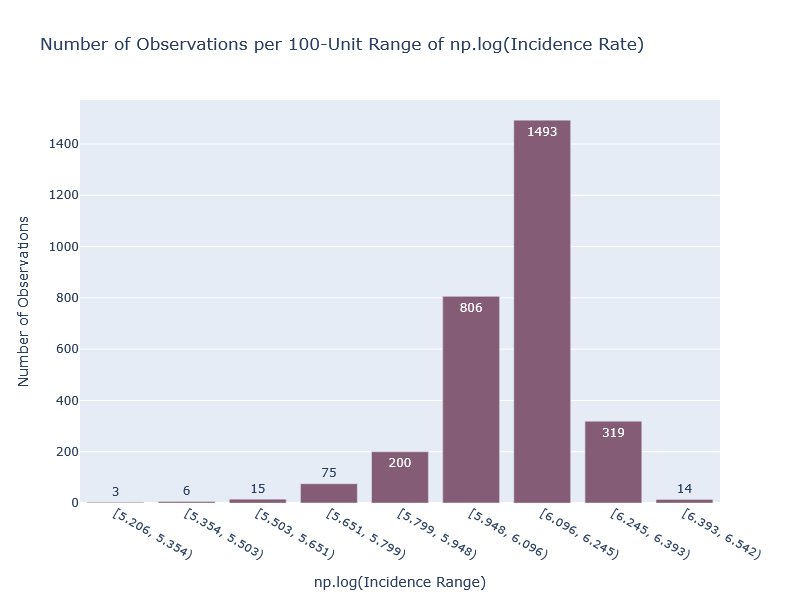

<br>

- Range distribution of log-transformed incidence rates
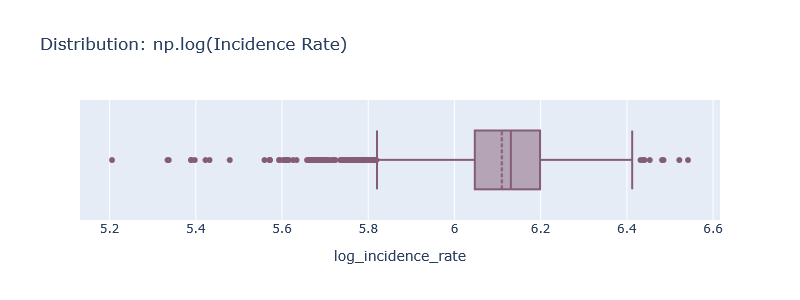

In [ ]:
import numpy as np
import pandas as pd
import plotly.express as px

# Apply log transformation (avoid log(0) issue)
binning_df = cancer_df.copy()
binning_df['log_incidence_rate'] = np.log(binning_df['incidence_rate'].replace(0, np.nan))

# Define bins for log-transformed values
bin_edges = np.linspace(binning_df['log_incidence_rate'].min(), binning_df['log_incidence_rate'].max(), num=10)

# Create bins and categorize values
binning_df['log_incidence_bin'] = pd.cut(binning_df['log_incidence_rate'], bins=bin_edges, right=False)

# Count observations per bin
count_df = binning_df['log_incidence_bin'].value_counts().reset_index()
count_df.columns = ['log_incidence_rate', 'count']
count_df = count_df[count_df['count'] > 0]  # Remove empty bins

# Convert bins to ordered categorical strings for correct plotting order
count_df['log_incidence_rate'] = count_df['log_incidence_rate'].astype(str)
count_df = count_df.sort_values(by='log_incidence_rate')

# Extract correct order for x-axis categories
custom_order = count_df['log_incidence_rate'].tolist()

# Plot the bar chart with correctly ordered log-transformed bins
fig = px.bar(
    count_df,
    x='log_incidence_rate',
    y='count',
    height=600, width=800,
    color_discrete_sequence=px.colors.qualitative.Antique,
    title='Number of Observations per 100-Unit Range of np.log(Incidence Rate)',
    labels={'log_incidence_rate': 'np.log(Incidence Range)', 'count': 'Number of Observations'},
    text_auto=True
)

# Ensure proper order of x-axis categories
fig.update_layout(
    xaxis={
        'categoryorder': 'array',
        'categoryarray': custom_order
    }
)
display(fig.show())

# Box plot using log-transformed incidence rate
overall_bx_plt = px.box(
    binning_df,
    x='log_incidence_rate',
    color_discrete_sequence=px.colors.qualitative.Antique,
    height=300,
    width=800,
    title='Distribution: np.log(Incidence Rate)'
)

overall_bx_plt.update_traces(
    boxmean=True,
    boxpoints='outliers',
    whiskerwidth=1,
    marker=dict(size=6)
)
display(overall_bx_plt.show())

None

None

#### Quantile Visualization of Geographic Distributions of Cancer Rate Tables

The visualization will give a sense of how the rates are distributed within the country on a county by county basis, excepting Kansas, Indiana, and a handful of additional counties within the country for which the Cancer Rate table does not have information. Notes:

1. Kansas and Indiana data is missing from the Cancer Rate Tables dataset. Imputation to the mean, median, and mode were considered and disregarded as inappropriate, as it results in the state being uniform in distribution throughout each of the counties within the state, which is an immediately noticeable anomaly compared to all other states.
2. Forward and backward neighbor fills for Kansas and Indiana were considered and disregarded as inappropriate; there is no immediately discernible pattern within the existing data suggesting such a relationship would be valid for neighboring counties, which frequently vary significantly between adjacent neighbors, and while there are numerous other ways to order the forward or backward fill, determining the appropriate ordering is beyond the scope of the project at this time.
3. The number of times the data is partitioned (k) changes the message of the maps considerably. As part of the exploratory process a loop was used to evaluate a range of k values from reasonable to unreasonable in size. Insights derived from this exploration included:
- It may be simpler and more effective to assess the data based on a binary continuum rather than a number of equal partitions. That is, patterns are quite difficult to determine intelligibly through visual examination of 4, 5, 6+ partitions to the range. But focusing on a division of low-medium incidence = 0 and high incidence = 1 does show patterns and points of concentration that may be more straightforward and effective to analyze.
- The presence of an extreme outlier (Union County, Florida at 1248.4 incidence per 100k population), which was more than 500 higher than the next nearest maximum incidence value, had a disruptive effect on quantile based mappings by dominating the upper range of the partitions and preventing meaningful partitioning of incidence rates in the upper quantile:

As a result, Union County was investigated and it was determined that it is a low-population (~16,000) county [1], that holds both a prison focused on medical treatment [2] and a medical treatment work camp [3], with a total combined population of 3,082 [4]. Investigation of the circumstances show evidence that Florida inmates from 51 Florida counties are transferred to this facility to receive treatment. Inmates so transferred, who then go on to receive a cancer diagnosis, are considered to have a Union County address [5]. In short, Union County, Florida cancer incidence rates are likely heavily skewed by the transfer of ill inmates from elsewhere in Florida into Union County for treatment. This is a potentially extreme confounding element; further, it is not related to geography or geographic health determinants. In recognition of the unique circumstance, the lack of relation to geographic health determinants, and the obnoxious effect the observation has on the geographic visualization, the decision was made to drop the county from the data set.

References:<br>
[1] “U.S. Census Bureau QuickFacts: Union County, Florida.” Accessed: Feb. 18, 2025. [Online]. Available: https://www.census.gov/quickfacts/fact/table/unioncountyflorida/PST045224 <br>
[2] F. D. of Corrections, “Reception and Medical Center / Institutions List / Institutions - Florida Department of Corrections.” Accessed: Feb. 18, 2025. [Online]. Available: https://www.fdc.myflorida.com/institutions/list-of-major-institutions/209 <br>
[3] “Reception and Medical Center Work Camp,” floridaprisonroster.org. Accessed: Feb. 18, 2025. [Online]. Available: https://floridaprisonroster.org/florida/state/reception-and-medical-center-work-camp/ <br>
[4] “Reception and Medical Center,” Wikipedia. Nov. 23, 2024. Accessed: Feb. 18, 2025. [Online]. Available: https://en.wikipedia.org/w/index.php?title=Reception_and_Medical_Center&oldid=1259064021 ,br>
[5] C. Crist and A. M. V. Ros, “Florida Annual Cancer Report: 2005 Incidence and Mortality Report.” Accessed: Feb. 18, 2025. [Online]. Available: https://www.floridahealth.gov/diseases-and-conditions/cancer/cancer-registry/reports/_documents/annual-reports/annualreport05.pdf <br>

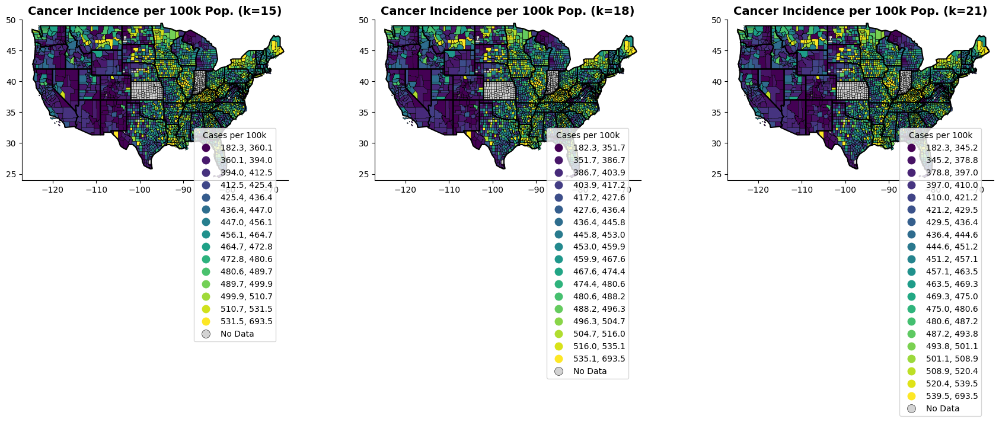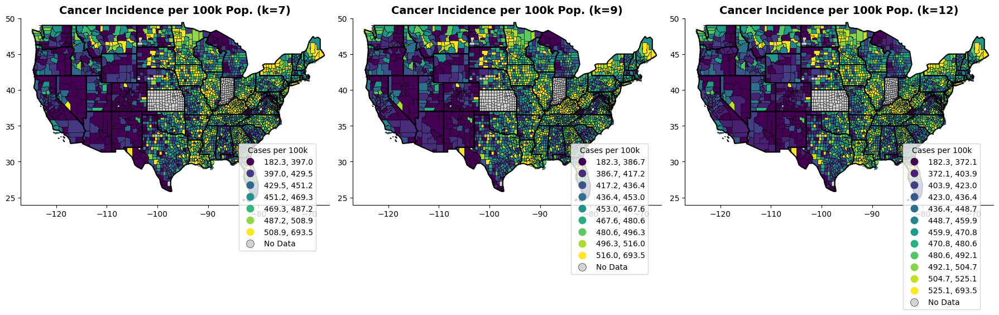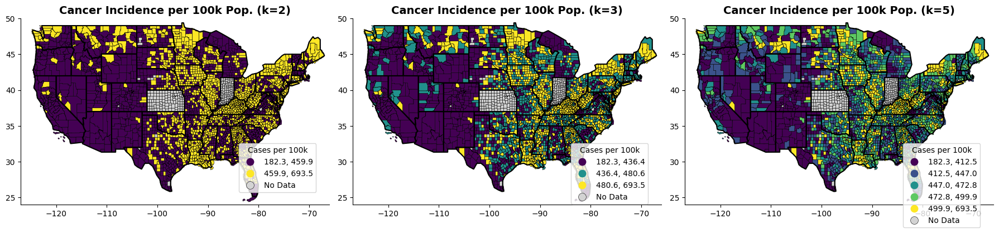

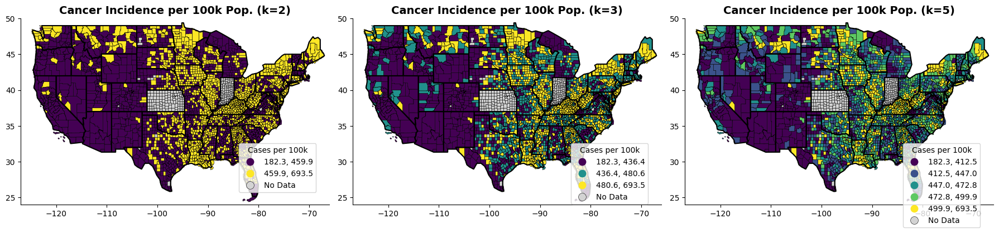

None

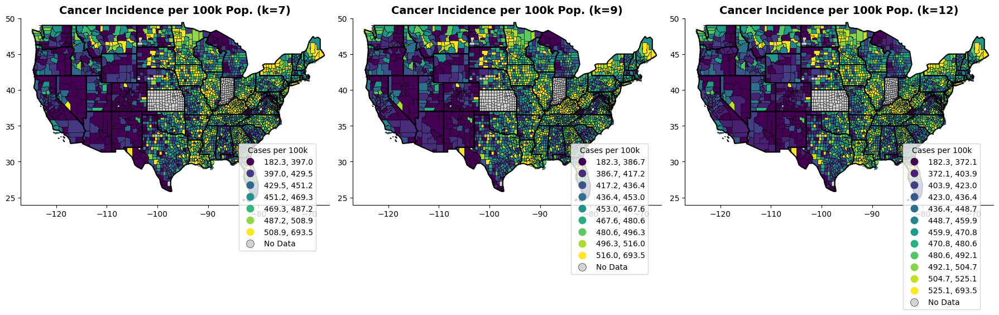

None

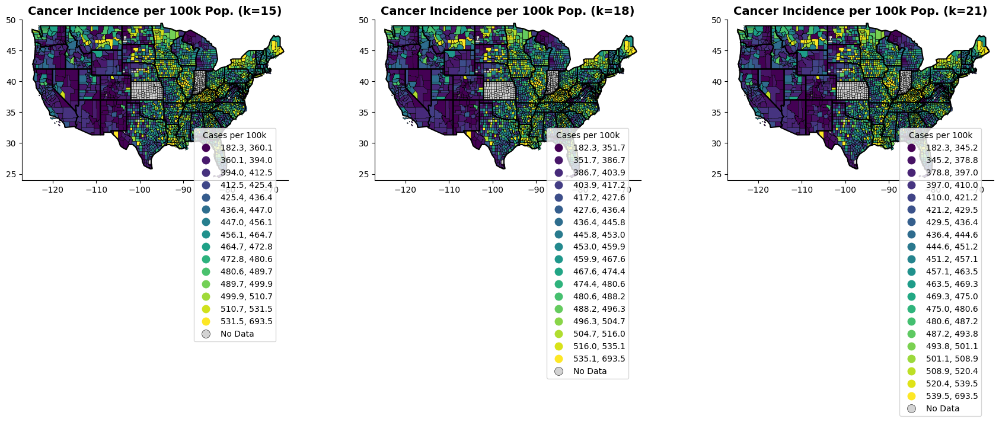

None

In [ ]:
# Merge cancer data and county boundaries.
county_shapes['fips'] = county_shapes['GEOID'].astype(int)
merged_df = county_shapes.merge(cancer_df, on='fips', how='left')

# Create a figure with 3 subplots for a side-by-side layout.
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Loop the image creation process to get three images side-by-side; will repeat
# two more times since we want 9 total maps and three is about the max that
# can be placed into an image and look decent while still fitting on a slide.
for ax, i in zip(axes, [2, 3, 5]):
  # Plot the map using quantiles.
  merged_df.plot(
      column='incidence_rate', cmap='viridis', linewidth=0.4, edgecolor='black',
      legend=True, ax=ax, scheme='quantiles', k=i,
      legend_kwds={
          'title': 'Cases per 100k',
          'fmt': '{:.1f}',
      },
      missing_kwds={'color': 'lightgrey', 'label': 'No Data'}
  )
  leg = ax.get_legend()
  leg.set_bbox_to_anchor((0.97, 0.35))
  # State boundaries.
  state_lines = gpd.read_file('/content/ne_110m_admin_1_states_provinces.shp')
  state_lines[state_lines['iso_a2'] == 'US'].plot(ax=ax, color='none', edgecolor='black', linewidth=1.5)

  # Format the map and remove axes spines.
  ax.set_title(f'Cancer Incidence per 100k Pop. (k={i})', fontsize=14, fontweight='bold')
  ax.set_xlim([-127, -66])
  ax.set_ylim([24, 50])
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)

# Adjust layout for better spacing between maps and show all three side by side.
plt.tight_layout()
display(plt.show())

# Map the next three k values.
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
for ax, i in zip(axes, [7, 9, 12]):
  # Plot the map using quantiles.
  merged_df.plot(
      column='incidence_rate', cmap='viridis', linewidth=0.4, edgecolor='black',
      legend=True, ax=ax, scheme='quantiles', k=i,
      legend_kwds={
          'title': 'Cases per 100k',
          'fmt': '{:.1f}',
      },
      missing_kwds={'color': 'lightgrey', 'label': 'No Data'}
  )
  leg = ax.get_legend()
  leg.set_bbox_to_anchor((0.97, 0.35))
  # State boundaries.
  state_lines = gpd.read_file('/content/ne_110m_admin_1_states_provinces.shp')
  state_lines[state_lines['iso_a2'] == 'US'].plot(ax=ax, color='none', edgecolor='black', linewidth=1.5)

  # Format the map and remove axes spines.
  ax.set_title(f'Cancer Incidence per 100k Pop. (k={i})', fontsize=14, fontweight='bold')
  ax.set_xlim([-127, -66])
  ax.set_ylim([24, 50])
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)

# Adjust layout for better spacing between maps and show all three side by side.
plt.tight_layout()
display(plt.show())

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
for ax, i in zip(axes, [15, 18, 21]):
  # Plot the map using quantiles.
  merged_df.plot(
      column='incidence_rate', cmap='viridis', linewidth=0.4, edgecolor='black',
      legend=True, ax=ax, scheme='quantiles', k=i,
      legend_kwds={
          'title': 'Cases per 100k',
          'fmt': '{:.1f}',
      },
      missing_kwds={'color': 'lightgrey', 'label': 'No Data'}
  )
  leg = ax.get_legend()
  leg.set_bbox_to_anchor((0.97, 0.35))
  # State boundaries.
  state_lines = gpd.read_file('/content/ne_110m_admin_1_states_provinces.shp')
  state_lines[state_lines['iso_a2'] == 'US'].plot(ax=ax, color='none', edgecolor='black', linewidth=1.5)

  # Format the map and remove axes spines.
  ax.set_title(f'Cancer Incidence per 100k Pop. (k={i})', fontsize=14, fontweight='bold')
  ax.set_xlim([-127, -66])
  ax.set_ylim([24, 50])
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)

# Adjust layout for better spacing between maps and show all three side by side.
plt.tight_layout()
display(plt.show())

#### Equal Interval Visualization of Geographic Distributions of Cancer Rate Tables

While quantile partitioning will produce roughly equal numbers of observations within each color bin, equal interval partitioning will standardize the range of color bins and thus produce mappings ranging from subtly to wildly different.

Using this mapping scheme we notice that, as in the quantile mapping, very high k values appear less useful than lower k values, with visual analysis becoming quite complicated beyond ~k=5. Additionally, the addition of higher k levels diminishes the presence of the high contrasting colors at the ends of the data ranges, likely due to the bulk of the data being located within three bins:

Ranges....Count...% of Total <br>
400-450---[797]-----0.271828104 <br>
450-500---[1103]---0.376193724 <br>
500-550---[498]-----0.169849932 <br>
3-bin total: 82%

The data appears to suggest some utility in instead dividing the observations into categorical ranges of binary outcomes with 500 representing a convenient point at which 80% of the data would belong to a low-medium outcome category and 20% at a high outcome category.

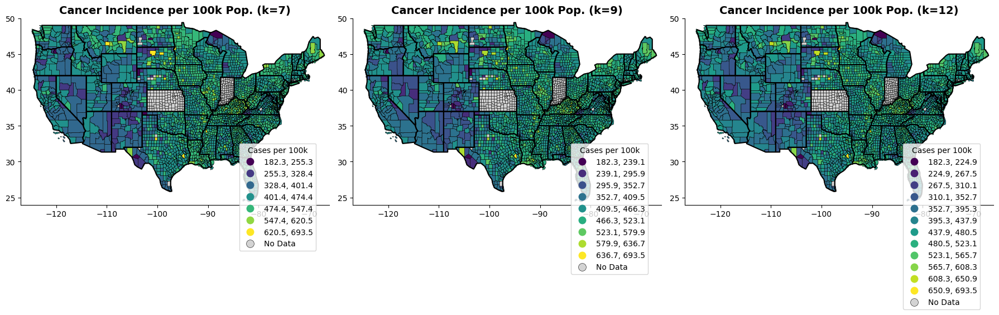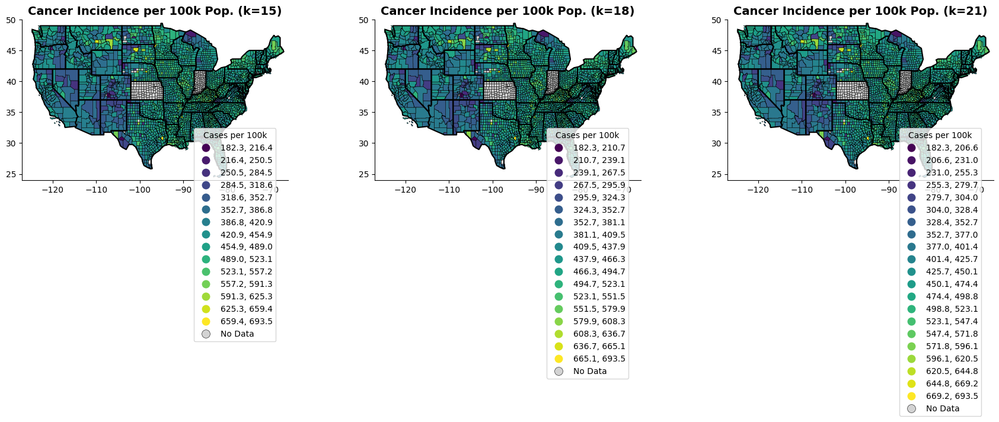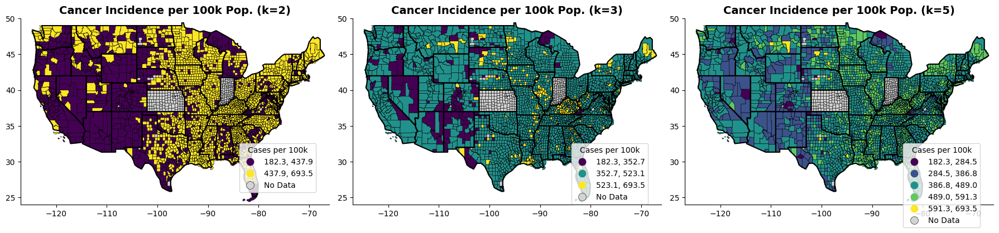

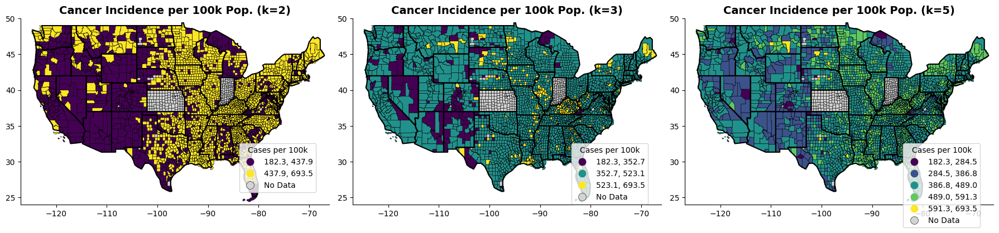

None

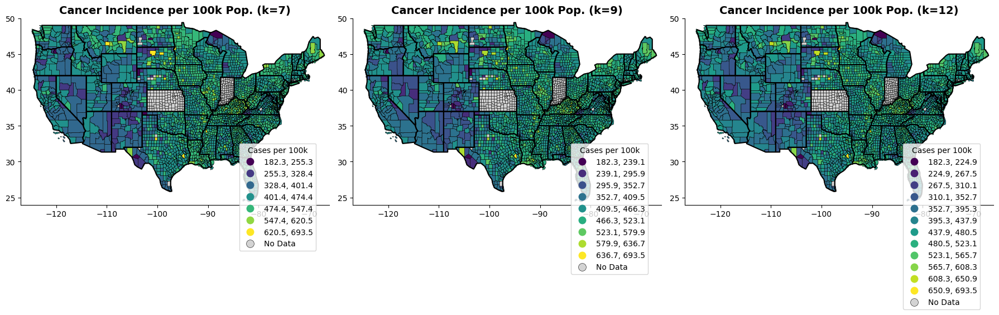

None

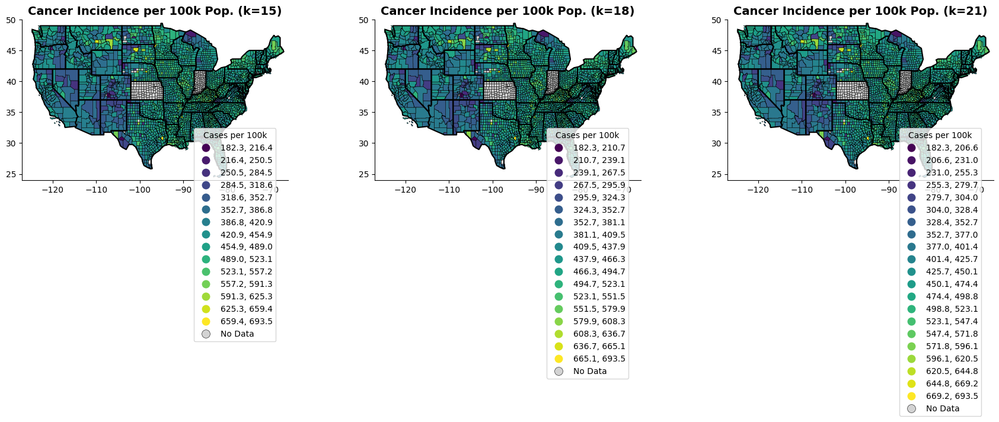

None

In [ ]:
# Merge cancer data and county boundaries.
county_shapes['fips'] = county_shapes['GEOID'].astype(int)
merged_df = county_shapes.merge(cancer_df, on='fips', how='left')

# Create a figure with 3 subplots for a side-by-side layout.
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Loop the image creation process to get three images side-by-side; will repeat
# two more times since we want 9 total maps and three is about the max that
# can be placed into an image and look decent while still fitting on a slide.
for ax, i in zip(axes, [2, 3, 5]):
  # Plot the map using quantiles.
  merged_df.plot(
      column='incidence_rate', cmap='viridis', linewidth=0.4, edgecolor='black',
      legend=True, ax=ax, scheme='equalinterval', k=i,
      legend_kwds={
          'title': 'Cases per 100k',
          'fmt': '{:.1f}',
      },
      missing_kwds={'color': 'lightgrey', 'label': 'No Data'}
  )
  leg = ax.get_legend()
  leg.set_bbox_to_anchor((0.97, 0.35))
  # State boundaries.
  state_lines = gpd.read_file('/content/ne_110m_admin_1_states_provinces.shp')
  state_lines[state_lines['iso_a2'] == 'US'].plot(ax=ax, color='none', edgecolor='black', linewidth=1.5)

  # Format the map and remove axes spines.
  ax.set_title(f'Cancer Incidence per 100k Pop. (k={i})', fontsize=14, fontweight='bold')
  ax.set_xlim([-127, -66])
  ax.set_ylim([24, 50])
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)

# Adjust layout for better spacing between maps and show all three side by side.
plt.tight_layout()
display(plt.show())

# Map the next three k values.
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
for ax, i in zip(axes, [7, 9, 12]):
  # Plot the map using quantiles.
  merged_df.plot(
      column='incidence_rate', cmap='viridis', linewidth=0.4, edgecolor='black',
      legend=True, ax=ax, scheme='equalinterval', k=i,
      legend_kwds={
          'title': 'Cases per 100k',
          'fmt': '{:.1f}',
      },
      missing_kwds={'color': 'lightgrey', 'label': 'No Data'}
  )
  leg = ax.get_legend()
  leg.set_bbox_to_anchor((0.97, 0.35))
  # State boundaries.
  state_lines = gpd.read_file('/content/ne_110m_admin_1_states_provinces.shp')
  state_lines[state_lines['iso_a2'] == 'US'].plot(ax=ax, color='none', edgecolor='black', linewidth=1.5)

  # Format the map and remove axes spines.
  ax.set_title(f'Cancer Incidence per 100k Pop. (k={i})', fontsize=14, fontweight='bold')
  ax.set_xlim([-127, -66])
  ax.set_ylim([24, 50])
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)

# Adjust layout for better spacing between maps and show all three side by side.
plt.tight_layout()
display(plt.show())

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
for ax, i in zip(axes, [15, 18, 21]):
  # Plot the map using quantiles.
  merged_df.plot(
      column='incidence_rate', cmap='viridis', linewidth=0.4, edgecolor='black',
      legend=True, ax=ax, scheme='equalinterval', k=i,
      legend_kwds={
          'title': 'Cases per 100k',
          'fmt': '{:.1f}',
      },
      missing_kwds={'color': 'lightgrey', 'label': 'No Data'}
  )
  leg = ax.get_legend()
  leg.set_bbox_to_anchor((0.97, 0.35))
  # State boundaries.
  state_lines = gpd.read_file('/content/ne_110m_admin_1_states_provinces.shp')
  state_lines[state_lines['iso_a2'] == 'US'].plot(ax=ax, color='none', edgecolor='black', linewidth=1.5)

  # Format the map and remove axes spines.
  ax.set_title(f'Cancer Incidence per 100k Pop. (k={i})', fontsize=14, fontweight='bold')
  ax.set_xlim([-127, -66])
  ax.set_ylim([24, 50])
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)

# Adjust layout for better spacing between maps and show all three side by side.
plt.tight_layout()
display(plt.show())

#### Visualization of Geographic Distributions of Cancer Rate Tables using Binary Outcome Categories

Visualization in binary categories using two bins, low-medium and high, clarifies some patterns immensely. The comparison with superfund site locations doesn’t reveal any smoking gun visual connection, although the extensive spread of superfund sites throughout the US ensures that there are some superfund sites within close proximity to the high incidence counties. Additional statistical tests will be necessary to tell for sure what the relationships are, and there are also additional tests that would be useful:
-	Checking based on estimated severity of pollution
-	Checking based on type of site (industrial: chemical, heavy metal, air, etc.)
-	Checking based on contaminant type
-	Checking based on source of contamination (ground, water, air, proximity, etc)
But I've run short of time to complete these tests before the due date and time, so these will need to be tested for the next EDA group presentation, if the group decides to pursue those routes.

But there does appear to be a promising and somewhat simpler test that can be applied by noticing that there are clusters and arms of high incidence counties that appear to run along the routes of three of the largest US rivers. This is discussed in the next section.



Binary Categorization (low-medium/high) Cancer Rate Table Visualization
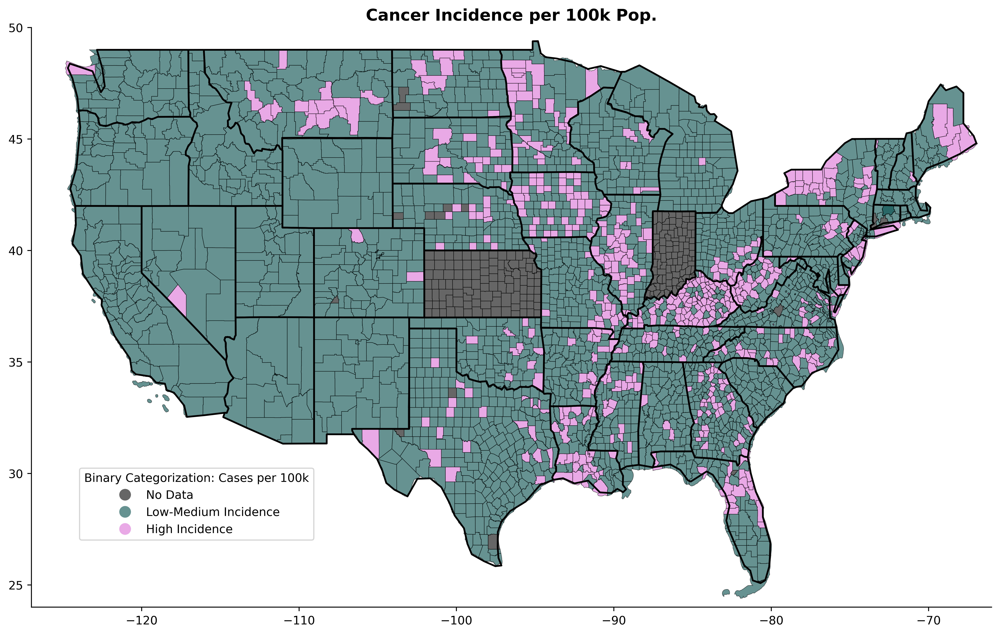

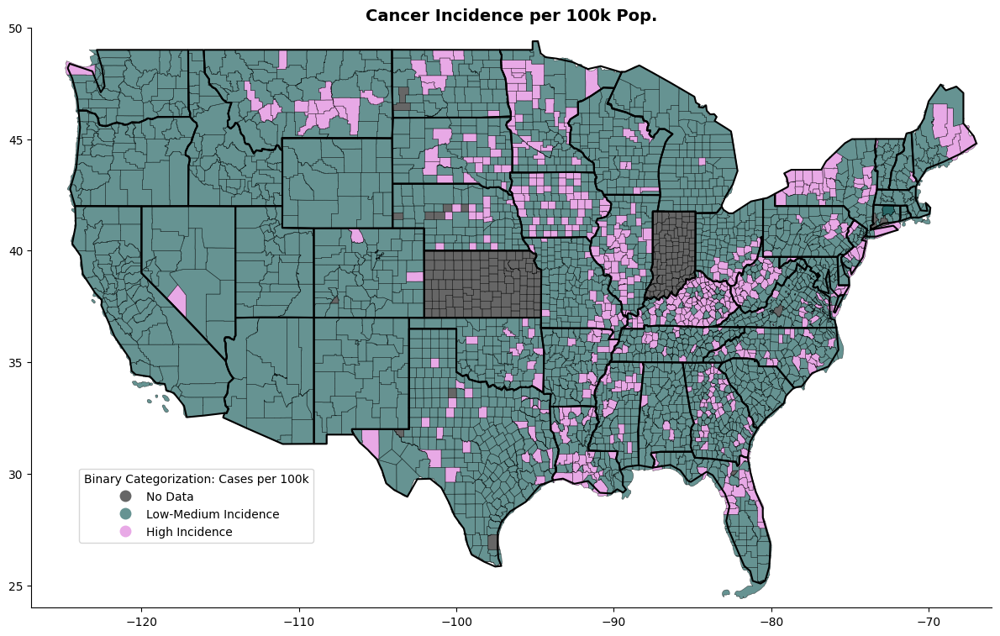

None

In [ ]:
# Convert to numeric, forcing non-numeric values to NaN
merged_df['incidence_rate'] = pd.to_numeric(merged_df['incidence_rate'], errors='coerce')

# Assign -1 if incidence_rate is 0 or NaN (non-numeric), otherwise apply existing condition
merged_df['Outcome'] = np.where(
    merged_df['incidence_rate'].isna() | (merged_df['incidence_rate'] == 0), -1,
    np.where(merged_df['incidence_rate'] < 500, 0, 1)
)
merged_df.head()

import matplotlib.colors as mcolors
import matplotlib.pyplot as plt

# Define a custom colormap with exact colors
custom_cmap = mcolors.ListedColormap(['black', '#004B49', '#DA70D6'])  # Black, Teal, Orchid

# Define the legend labels mapping
legend_labels = {-1: 'No Data', 0: 'Low-Medium Incidence', 1: 'High Incidence'}

fig, ax = plt.subplots(figsize=(12, 8))

# Apply the color scheme in the plot
merged_df.plot(
    column='Outcome', cmap=custom_cmap, linewidth=0.4, edgecolor='black',
    legend=True, ax=ax, categorical=True, alpha=0.6,
    legend_kwds={'title': 'Binary Categorization: Cases per 100k'},
    missing_kwds={'color': 'lightgrey', 'label': 'No Data'}
)

# Modify legend labels manually
leg = ax.get_legend()
leg.set_bbox_to_anchor((0.3, .25))

# Replace numeric labels with custom text labels
for text in leg.get_texts():
    label_value = int(float(text.get_text()))  # Convert label text to int
    if label_value in legend_labels:
        text.set_text(legend_labels[label_value])  # Replace with custom text

# Add state boundaries
state_lines = gpd.read_file('/content/ne_110m_admin_1_states_provinces.shp')
state_lines[state_lines['iso_a2'] == 'US'].plot(ax=ax, color='none', edgecolor='black', linewidth=1.5)

# Format the map
ax.set_title('Cancer Incidence per 100k Pop.', fontsize=14, fontweight='bold')
ax.set_xlim([-127, -66])  # US map longitude range
ax.set_ylim([24, 50])  # US map latitude range

# Remove axis spines for a clean look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout for better spacing
plt.tight_layout()
plt.savefig('incidence_binary', dpi=500, bbox_inches='tight')
display(plt.show())

## Adding Waterways

While previous visualizations were disappointing in terms of suggesting relationships with Superfund sites (at least based on naive whole-data-set distribution of sites), overlaying three of the largest US rivers on the binary low-medium/high cancer incidence visualization suggests some interesting avenues for analysis.
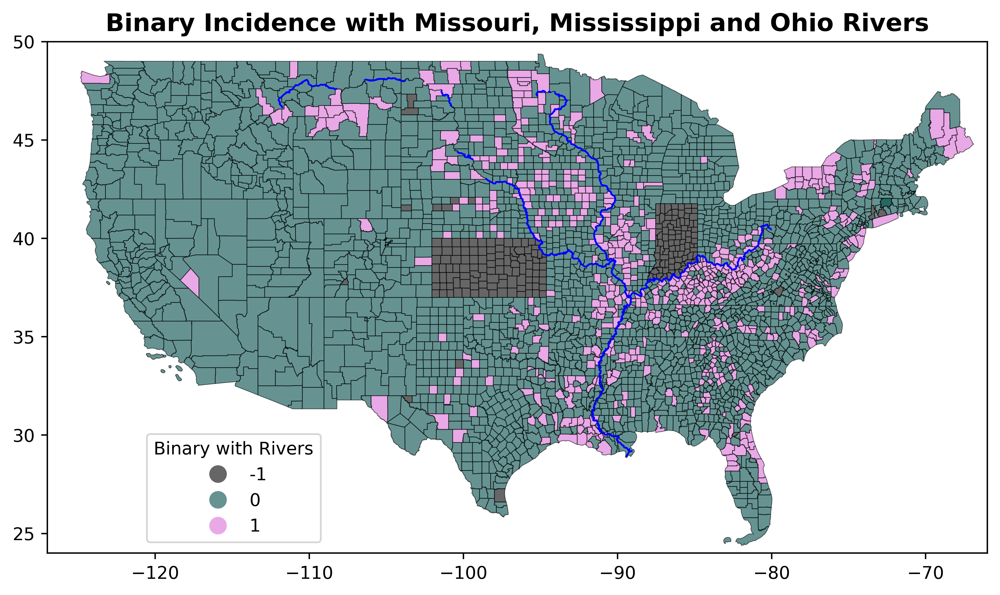

Notice:

*   For large portions of their routes, each river runs through or borders a series of high-rate counties.
*   Iowa, which wedged between the Missouri and Mississippi, and has both longitudinal borders largely defined by a major river, has high-incidence counties throughout the state, in a distributed pattern, with more of the state covered in high-incidence counties than is found in other states (excepting Kentucky).
*   'Arms' of high-incidence bands converge at the tip of Illinois, where these three rivers have their ultimate confluence, and then seem to continue to follow the path tightly bound to the course of the Lower Mississippi all the way to the river mouth.

The visual analysis is suggestive, but not conclusive. There are factors that could explain the pattern, both related to the river and not related to the river.
- Rivers may have influenced the growth of urban areas, industrial centers and farming patterns due to factors like ease of travel and sourcing water, creating a pattern of high incidence incidentally related to the course of the river.
- Midwestern states like Iowa could be seeing patterns of high incidence not related to the rivers, but rather to the extent of agriculture-related exposures.
- Iowa and Minnesota are likely to see higher incidence rates than would otherwise be expected as a result of higher than average levels of Radon within the state.
- Kentucky is likely to be affected in incidence rate by high levels of mining and air pollution from coal mining and burning for energy.

Next steps:
- Add Superfund sites.
- Overlay Radon Zone Category Map.
- Compare visuals of agricultural output.
- Find and assess mine and air pollution data for Kentucky.


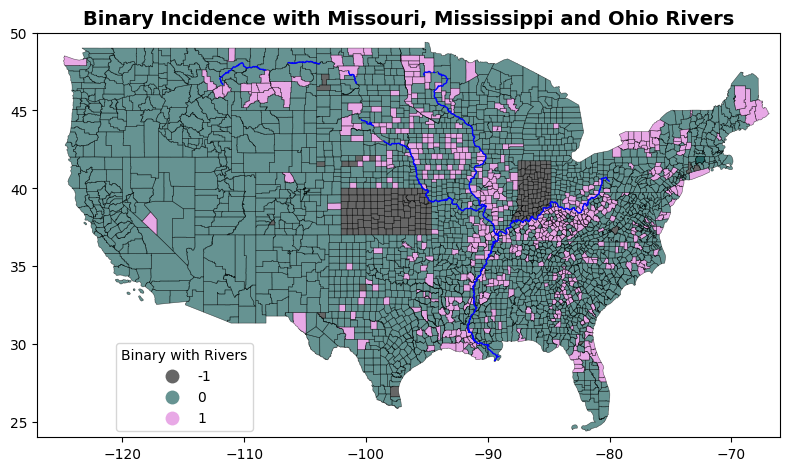

In [ ]:
river_shapes = gpd.read_file('/content/ne_10m_rivers_lake_centerlines.shp')

# Retain only what I need.
river_shapes = river_shapes[
    (river_shapes['name'].isin(['Ohio', 'Missouri', 'Mississippi'])) &
    (river_shapes['featurecla'] == 'River')
]

fig, ax = plt.subplots(figsize=(8, 6))

# Plot the base map.
merged_df.plot(
    column='Outcome', cmap=custom_cmap, linewidth=0.4, edgecolor='black',
    legend=True, ax=ax, categorical=True, alpha=0.6,
    legend_kwds={'title': 'Binary with Rivers'},
    missing_kwds={'color': 'lightgrey', 'label': 'No Data'}
)
# Format the map
ax.set_title('Binary Incidence with Missouri, Mississippi and Ohio Rivers', fontsize=14, fontweight='bold')
ax.set_xlim([-127, -66])  # US map longitude range
ax.set_ylim([24, 50])  # US map latitude range

# Plot Missouri and Mississippi Rivers.
river_shapes.plot(ax=ax, color='blue', linewidth=1)
leg = ax.get_legend()
leg.set_bbox_to_anchor((0.3, .25))

# Display a nice pleasing map with a couple-three of rivers.
plt.tight_layout()
plt.savefig('incidence_tri-river.png', dpi=500, bbox_inches='tight')
plt.show()

#### Next Steps

The EDA has enabled the identification of an interesting avenue of analysis, but is not at this time conclusive. Unfortunately the time-intensive nature of exploring the spatial relations prevents the completion of certain additional analsysis steps before it is necessary to submit the EDA, leaving some action items to be assessed post-submission.

In addition to those discussed in the previous section, it becomes obvious that additional effort should be made to discover why Kansas and Indiana are not included in the Cancer Incidence Rate Tables, and assess if that information can be located and merged with the existing data - both states would offer additional clarity.
- Consider that the entire souther border of Indiana is adjacent to the Ohio River, in a spot that neighboring Kentucky sees an extensive swath of high incidence counties. Thus the Indiana data would provide support for the hypothesis of river-based environmental health determinants if high incidence Indiana counties clustered along the river in the same way they do in Ohio.
- Consider the high incidence rates seen along the path of the Missouri river are largely absent from southern Iowa through western and middle Missouri. In that stretch of low incidence counties, the Missouri River touches the northeastern tip of Kansas, and the presence or absence of high incidence counties in this northeastern tip would be quite informative.

#### Take-aways
- Binary classification of cancer rates appears to best highlight patterns in the areas of concern throughout the US.
- Additional examination is needed to identify patterns related to cancer incidence and superfund sites, likely including deeper-than-visual-analysis tests of a statistical nature and/or categorizing superfund sites by type, severity or contaminant-of-primary-concern.
- Clusters and arms of high incidence cancer rates appear to hew closely to the path of three of the largest rivers in the continental US: The Missouri, Mississippi and Ohio rivers, with the Mississippi and Ohio frequently being cited in non-scientific sources as two of the most highly polluted in the United States:

> ... river and the states most responsible for the polluted conditions of the river.
> 1. Mississippi River TN, AR, LA, MO, IL, MN, WI, IA, KY, MS
> 2. Pacific Ocean OR, HI, CA
> 3. Ohio River IL, IN, OH, KY, WV, PA
> ...
> List sampled for illustrative purposes from: <br>
> [1] “WHERE ARE AMERICA’S TEN MOST POLLUTED RIVERS?,” APEC WATER. Accessed: Feb. 19, 2025. [Online]. Available: https://www.freedrinkingwater.com/blogs/water-quality/1-americas-ten-most-polluted-rivers

- The above suggests another possible route of analysis is that of targeting rivers known to be highly polluted to determine their rate of bordering high incidence counties as well.

In [ ]:
end_time = datetime.datetime.now()
runtime = end_time - start_time
display('Runtime:', runtime)

'Runtime:'

datetime.timedelta(seconds=471, microseconds=417762)